# Problem set 1 : Seeing in Color

#### in case this file doesn't look right, you can open it in nbviewer

[LINK TO FILE](https://nbviewer.org/github/sbarrios93/Computer-Vision-Class-Winter-2022/blob/main/ps1/sebastian-barrios-sol1.ipynb)

## Part 1: Color Alignment

In [243]:
# This cell sets up inline image display functionaility
%matplotlib inline
import matplotlib.pyplot as plt

In [244]:
# import packages we will need
import numpy as np
import cv2  # if you don't have it, you can install it in anaconda prompt: pip install opencv-python
import matplotlib.image as mpimg


import scipy
import scipy.ndimage
from imageio import imread, imsave

In [245]:
def plot_image(img, size, cmap=None):
    plt.figure(figsize=size)
    plt.imshow(img, cmap=cmap)
    plt.axis('off')
    plt.show()

### Naive stacking
If we simply ignore the shifts, we get a distorted image of course:

Image height 370 x width 370


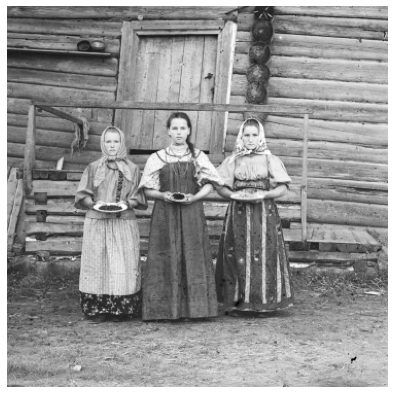

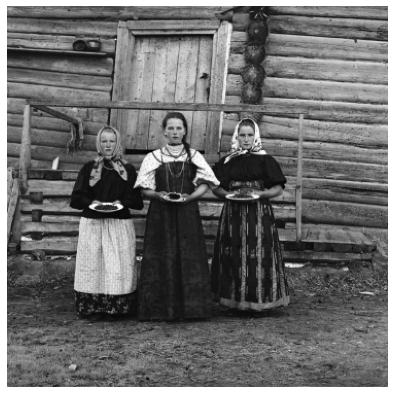

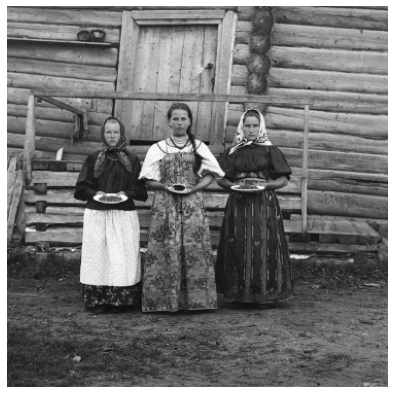

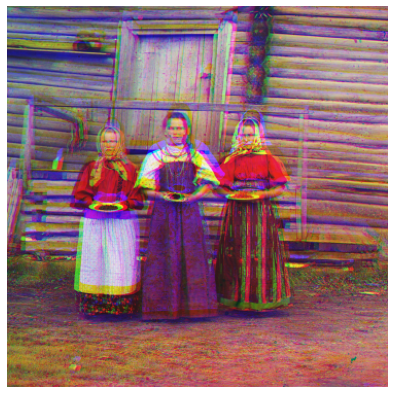

In [246]:
# A demo of naive stacking

red = np.array(imread('images/prokudin-girls-red.ppm', as_gray=True) / 255.0)
blue = np.array(imread('images/prokudin-girls-blue.ppm', as_gray=True) / 255.0)
green = np.array(imread('images/prokudin-girls-green.ppm', as_gray=True) / 255.0)

print('Image height %d x width %d'% (blue.shape[0],blue.shape[1]))

for layer in [red, green, blue]:
    plot_image(layer, (14, 7), 'gray')

# now try to just superimpose the three channels
color = np.stack((red, green, blue), axis=-1)
plot_image(color, (14, 7))

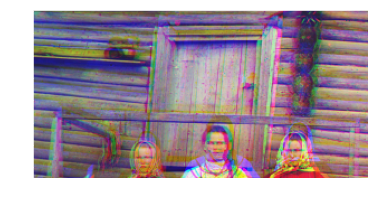

In [247]:
# note the image axis convention vs plot axis convention. Image origin (0, 0) sits at the top-left corner of the plot. 
# image shape [height, width, channel]. height comes first. 
plt.imshow(color[0:150, 0:300, :])  # a crop at the top-left corner
plt.show()

## Synthetic experiment
We will start by simulating the shifts by taking a color image obtained with modern color camera, inducing color channel misalignment by shifting the color channels. Then we can attempt to recover the original image by finding the shifts that minimize the SSD between the (un)shifted channels.

### Problem 1: Implement this by completing the code below.

In [248]:
# note that y-axis is dimention 0. x-axis is dimension 1. 

def shift_image_y(input_image, dy):
    input_image = np.roll(input_image, dy, axis=0)
    return input_image 

def shift_image_x(input_image, dx):
    input_image = np.roll(input_image, dx, axis=1)
    return input_image


def apply_shift(input_image, dy, dx):
    return shift_image_y(
        shift_image_x(input_image, dx), 
        dy
    )

Now we can look at the original image; the image with shifted channels stacked naively; and the restored image where we invert the shifts using the optimal value found. This final image should match the original (other than near the borders, of course, where the shifting loses information) 

(207, 384, 3)


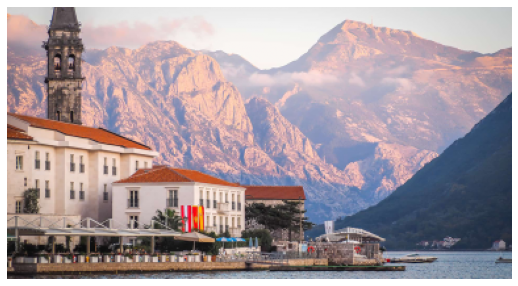

In [249]:
test_image = np.array(imread('images/test-image.png') / 255.0)
print(test_image.shape)
# show the original image
plot_image(test_image, (10, 5))

Real shift: R [y: 14, x: 10], B [y: 8, x: -1]


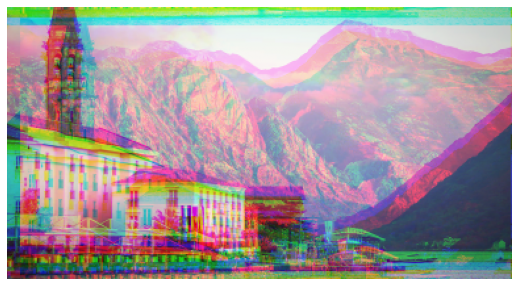

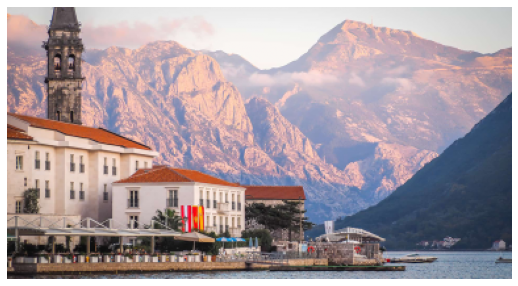

In [250]:
red_shift = np.random.randint(-15, 15, (2,));
red_channel = apply_shift(test_image[..., 0], *red_shift)

green_channel = test_image[..., 1]

blue_shift = np.random.randint(-15, 15, (2,));
blue_channel = apply_shift(test_image[..., 2], *blue_shift)

print('Real shift: R [y: %d, x: %d], B [y: %d, x: %d]' % (*red_shift, *blue_shift))

synth_image = np.stack((red_channel, green_channel, blue_channel), axis=-1)

# show the naive stacking result (should be distorted)
plot_image(synth_image, (10, 5))

# and finally add your code here to show the image with color channels aligned using the knowledge of the 
# ground truth (correct) shift values
red_channel_correct = apply_shift(red_channel, *red_shift*-1)
blue_channel_correct = apply_shift(blue_channel, *blue_shift*-1)
corrected_image = np.stack((red_channel_correct, green_channel, blue_channel_correct), axis=-1)
plot_image(corrected_image, (10, 5))


### Problem 2: Automatic alignment

Complete the code implementing the procedure for aligning the color channels as outlined in the assignment

In [251]:
def SSD(A, B):
    return np.sum((A - B) ** 2)


def get_optimal_shift(shifted_color, fixed_color, max_shift=15):
    min_ssd = np.inf
    y_shift = 0
    x_shift = 0
    
    # get an array of all possible combinations of shifts
    all_shifts = np.array(np.meshgrid(range(-max_shift, max_shift + 1), range(-max_shift, max_shift + 1))).T.reshape(-1, 2)
    
    
    for shifted_y, shift_x in all_shifts:
        shifted_color_iter = apply_shift(shifted_color, shifted_y, shift_x)
        ssd = SSD(shifted_color_iter, fixed_color)
        if ssd < min_ssd:
            min_ssd = ssd
            y_shift, x_shift = shifted_y, shift_x
    return y_shift, x_shift
    
    

Test it on our synthetic example:

Correction shift: R [y: -14, x: -10], B [y: -8, x: 1]


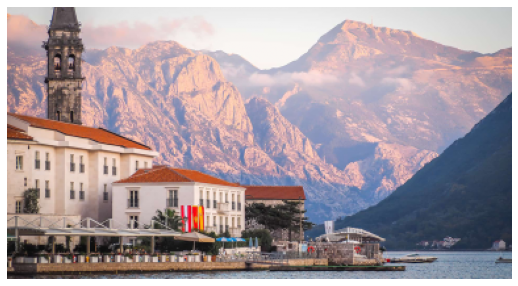

In [252]:
optimal_red =  get_optimal_shift(red_channel, green_channel, max_shift=15)
optimal_blue = get_optimal_shift(blue_channel, green_channel, max_shift=15)

print('Correction shift: R [y: %d, x: %d], B [y: %d, x: %d]'% (*optimal_red, *optimal_blue))

fixed_image = synth_image.copy()
fixed_image[..., 0] = apply_shift(red_channel, *optimal_red)
fixed_image[..., 2] = apply_shift(blue_channel, *optimal_blue)

plot_image(fixed_image, (10, 5))

### Problem 3: Aligning Prokudin-Gorskii triptychs

(0, -4)
(9, -5)
Naively Stacked Image


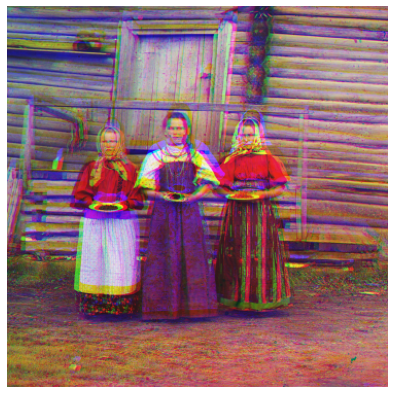

Fixed Image


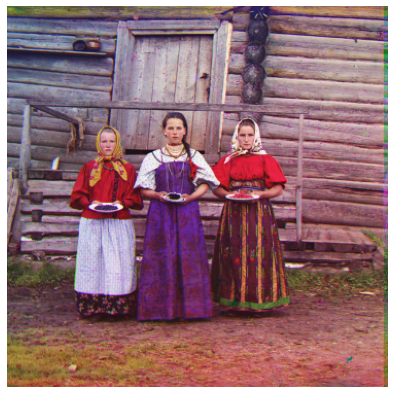

In [253]:

red = np.array(imread('images/prokudin-girls-red.ppm', as_gray=True) / 255.0)
blue = np.array(imread('images/prokudin-girls-blue.ppm', as_gray=True) / 255.0)
green = np.array(imread('images/prokudin-girls-green.ppm', as_gray=True) / 255.0)

naive_stacked_image = np.dstack((red, green, blue))

optimal_red =  get_optimal_shift(red, green, max_shift=15)
optimal_blue = get_optimal_shift(blue, green, max_shift=15)

print(optimal_red)
print(optimal_blue)

red_fixed = apply_shift(red, *optimal_red)
blue_fixed = apply_shift(blue, *optimal_blue)

fixed_image = np.dstack((red_fixed, green, blue_fixed))

print('Naively Stacked Image')
plot_image(naive_stacked_image, (14, 7))
print('Fixed Image')
plot_image(fixed_image, (14, 7))

and the other one:

(3, 3)
(-2, -8)
Naively Stacked Image


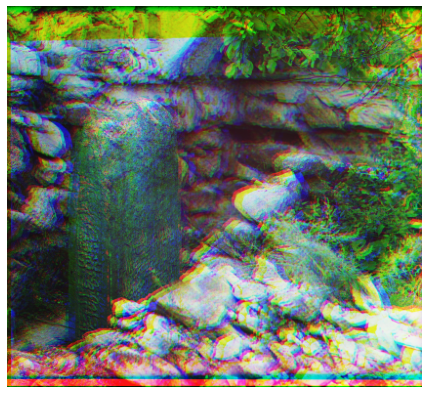

Fixed Image


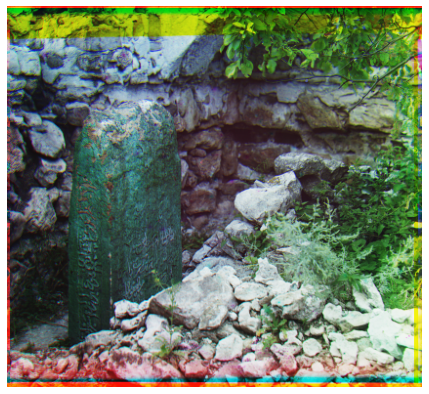

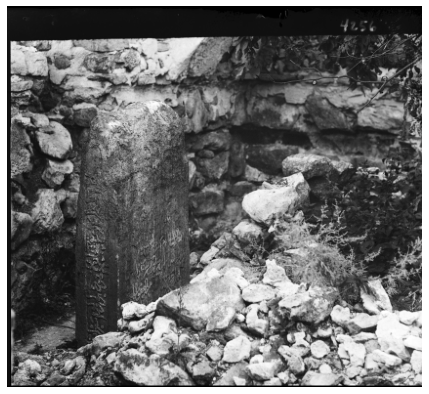

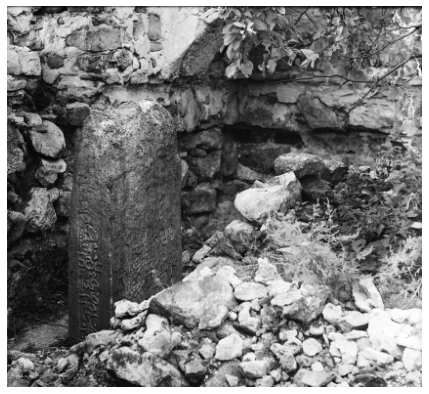

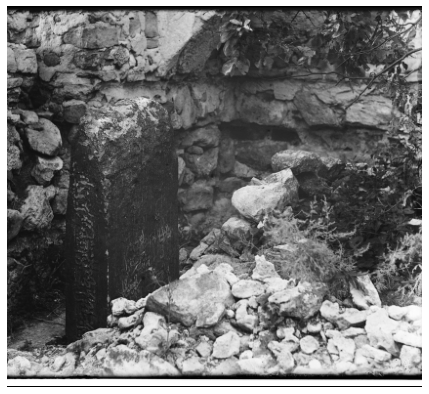

In [254]:
red = np.array(imread('images/prokudin-rock-red.ppm',as_gray=True) / 255.0)
blue = np.array(imread('images/prokudin-rock-blue.ppm',as_gray=True) / 255.0)
green = np.array(imread('images/prokudin-rock-green.ppm',as_gray=True) / 255.0)

naive_stacked_image = np.dstack((red, green, blue))

optimal_red =  get_optimal_shift(red, green, max_shift=15)
optimal_blue = get_optimal_shift(blue, green, max_shift=15)

print(optimal_red)
print(optimal_blue)

red_fixed = apply_shift(red, *optimal_red)
blue_fixed = apply_shift(blue, *optimal_blue)

fixed_image = np.stack((red_fixed, green, blue_fixed), axis=-1)

print('Naively Stacked Image')
plot_image(naive_stacked_image, (14, 7))
print('Fixed Image')
plot_image(fixed_image, (14, 7))

plot_image(blue, (14, 7), "gray")
plot_image(green, (14, 7), "gray")
plot_image(red, (14, 7), "gray")

### Problem 3 Bonus 
Add here results on any additional triptychs

#### Steps to obtain the triptychs

1. Download the image in `.tif` format 
2. Set cropping aspect ratio to 100:88.75
3. Scale the images to `400` width and maintain aspect ratio
4. Save each channel as single image in `.pbm` format

#### Emir

(0, 4)
(8, -1)
Naively Stacked Image


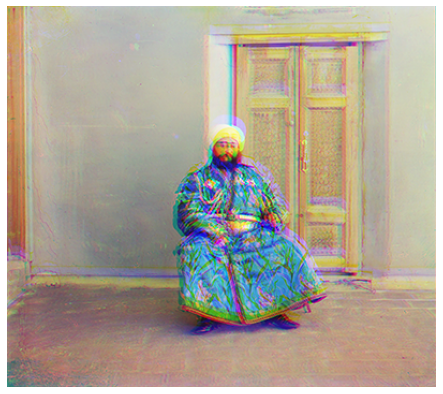

Fixed Image


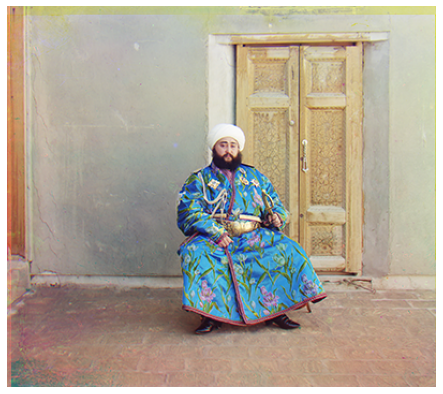

Blue Channel


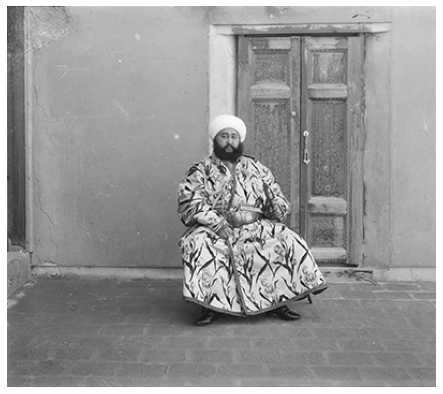

Green Channel


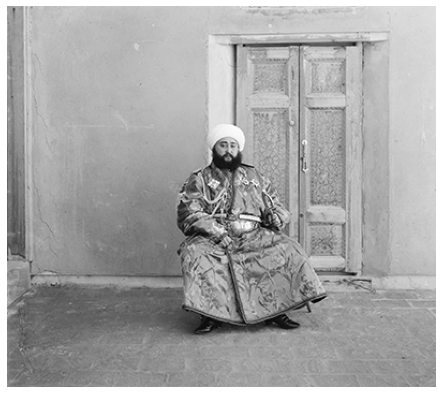

Red Channel


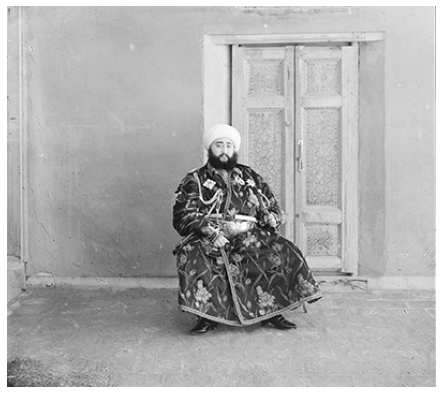

In [255]:
red = np.array(imread('images/p-3-bonus/prokudin-emir-red.pbm',as_gray=True) / 255.0)
blue = np.array(imread('images/p-3-bonus/prokudin-emir-blue.pbm',as_gray=True) / 255.0)
green = np.array(imread('images/p-3-bonus/prokudin-emir-green.pbm',as_gray=True) / 255.0)

naive_stacked_image = np.dstack((red, green, blue))

optimal_red =  get_optimal_shift(red, green, max_shift=15)
optimal_blue = get_optimal_shift(blue, green, max_shift=15)

print(optimal_red)
print(optimal_blue)

red_fixed = apply_shift(red, *optimal_red)
blue_fixed = apply_shift(blue, *optimal_blue)

fixed_image = np.stack((red_fixed, green, blue_fixed), axis=-1)

print('Naively Stacked Image')
plot_image(naive_stacked_image, (14, 7))
print('Fixed Image')
plot_image(fixed_image, (14, 7))


print('Blue Channel')
plot_image(blue, (14, 7), "gray")
print('Green Channel')
plot_image(green, (14, 7), "gray")
print('Red Channel')
plot_image(red, (14, 7), "gray")

#### Milan Cathedral

[Link](https://www.loc.gov/pictures/collection/prok/item/2018679118/)

(8, -5)
(21, 10)
Naively Stacked Image


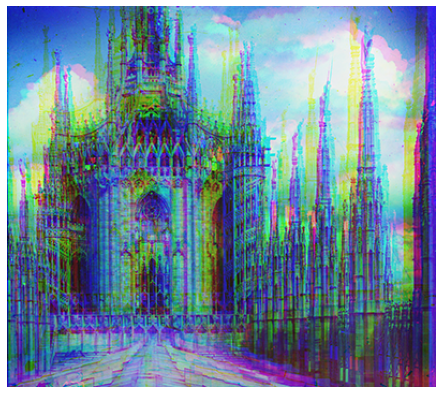

Fixed Image


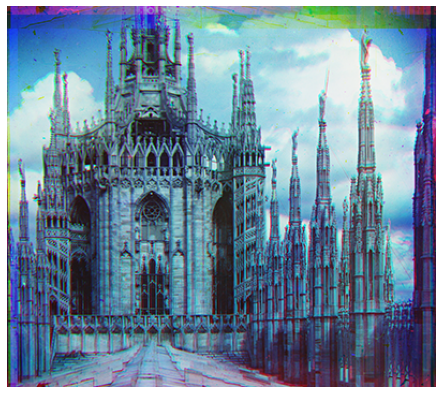

Blue Channel


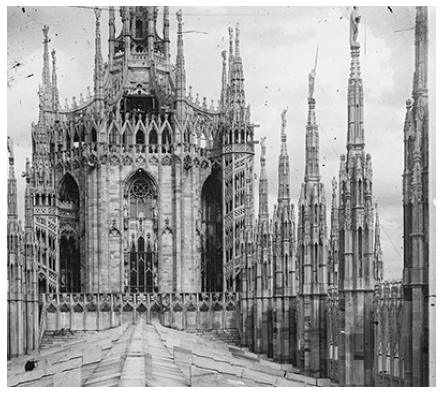

Green Channel


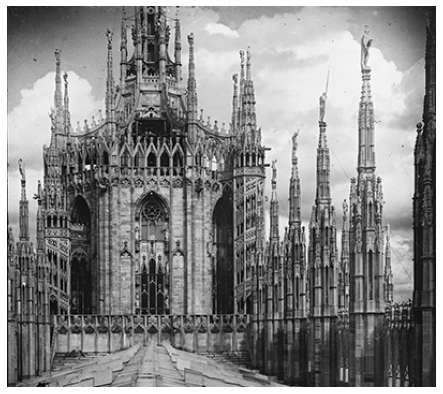

Red Channel


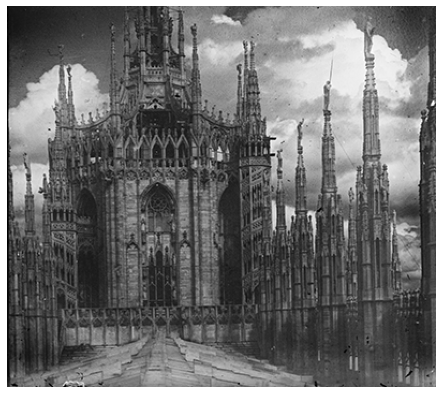

In [256]:
red = np.array(imread('images/p-3-bonus/prokudin-cathedral-red.pbm',as_gray=True) / 255.0)
blue = np.array(imread('images/p-3-bonus/prokudin-cathedral-blue.pbm',as_gray=True) / 255.0)
green = np.array(imread('images/p-3-bonus/prokudin-cathedral-green.pbm',as_gray=True) / 255.0)

naive_stacked_image = np.dstack((red, green, blue))

optimal_red =  get_optimal_shift(red, green, max_shift=30)
optimal_blue = get_optimal_shift(blue, green, max_shift=30)

print(optimal_red)
print(optimal_blue)

red_fixed = apply_shift(red, *optimal_red)
blue_fixed = apply_shift(blue, *optimal_blue)

fixed_image = np.stack((red_fixed, green, blue_fixed), axis=-1)

print('Naively Stacked Image')
plot_image(naive_stacked_image, (14, 7))
print('Fixed Image')
plot_image(fixed_image, (14, 7))


print('Blue Channel')
plot_image(blue, (14, 7), "gray")
print('Green Channel')
plot_image(green, (14, 7), "gray")
print('Red Channel')
plot_image(red, (14, 7), "gray")

## Demosaicing

### load the mosaiced image
This is a single channel (graylevel) image, which as we know encodes color via a Bayer pattern

In [257]:
image_path = 'images/crayons.bmp'

def read_image(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    return image

mosaic_img = read_image(image_path)

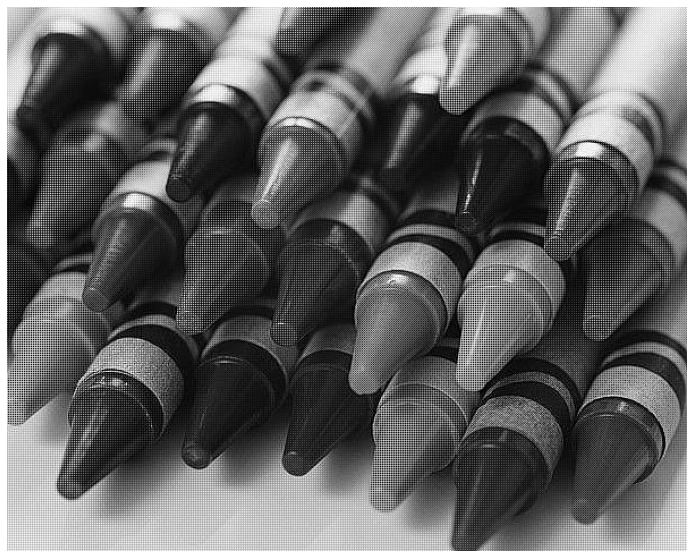

In [258]:
# Visualize the mosaic
plot_image(mosaic_img, (20, 10), 'gray')

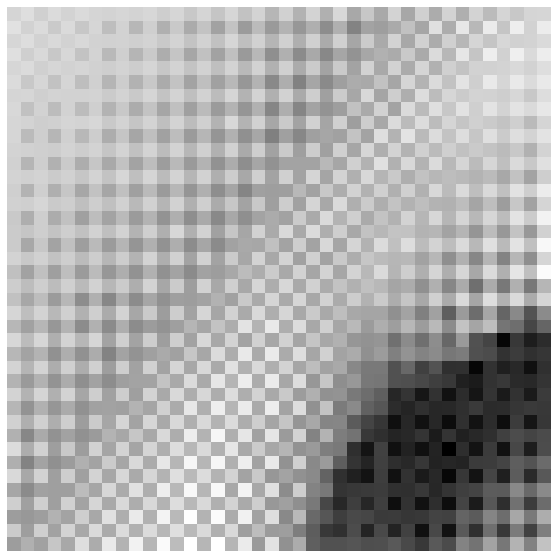

In [259]:
plot_image(mosaic_img[:40, :40], (20, 10), 'gray')

In [260]:
from scipy.ndimage.filters import convolve

In [261]:
# your code here; create the masks that correpond to each color pixel
def get_masked_channels(image):
    img_shape = image.shape
    
    masks = {'R_m':None, 'G_m':None, 'B_m':None}

    for color in masks.keys():
        masks[color] = np.zeros(img_shape).astype(bool)
    masks['R_m'][0::2, 0::2] = True
    masks['G_m'][0::2, 1::2] = True
    masks['G_m'][1::2, 0::2] = True
    masks['B_m'][1::2, 1::2] = True

    return (mask for mask in masks.values())


R_m, G_m, B_m = get_masked_channels(mosaic_img)

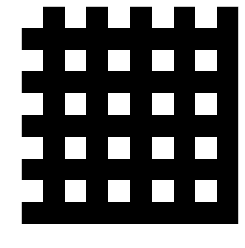

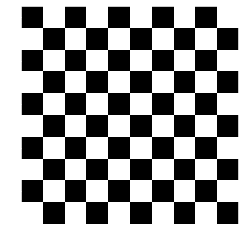

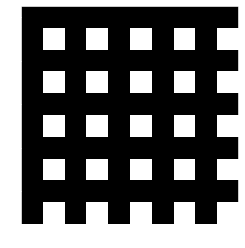

In [262]:
plt.imshow(R_m[:10,:10], cmap='gray')
plt.show()

plt.imshow(G_m[:10,:10], cmap='gray')
plt.show()

plt.imshow(B_m[:10,:10], cmap='gray')
plt.show()

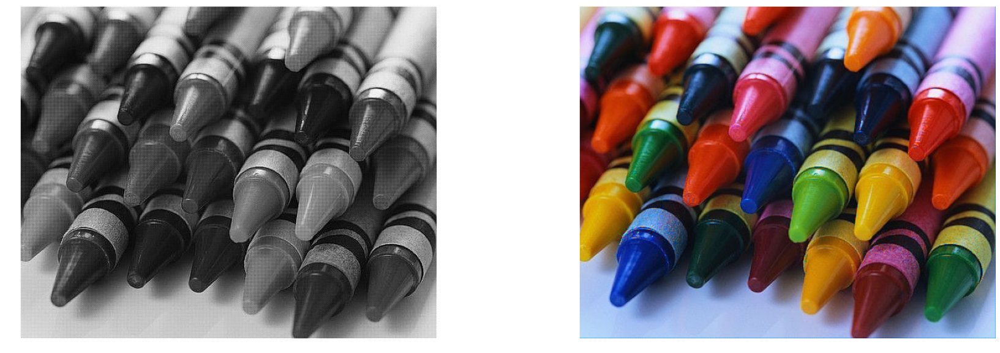

In [263]:
# Hint: apply filtering on masked layers. 
# Think about the right filter weights as they move to differen pixel locations. 
# The idea here is: if a pixel already has an assigned color, leave it unchanged. 
# Only fill in the color for the missing pixels. 

# Masking + Convolution by appropriate filter simplifies problem
# convolution kernels

# green filter
H_G = np.asarray(
    [[0, 1, 0],
     [1, 4, 1],
     [0, 1, 0]]) / 4
# red/blue filter
H_RB = np.asarray(
    [[1, 2, 1],
     [2, 4, 2],
     [1, 2, 1]]) / 4

# your code here
R = convolve((R_m * mosaic_img) ,H_RB, mode='constant', cval=0)
G = convolve((G_m * mosaic_img) ,H_G, mode='constant', cval=0)
B = convolve((B_m * mosaic_img) ,H_RB, mode='constant', cval=0)

rgb = np.stack((R,G,B), axis=-1)


fig, axs = plt.subplots(1, 2, figsize=(30, 10))
axs[0].imshow(mosaic_img, cmap='gray')
axs[1].imshow(rgb)

To help us see the effect (and differences with the other method) zoom in on a small portion:

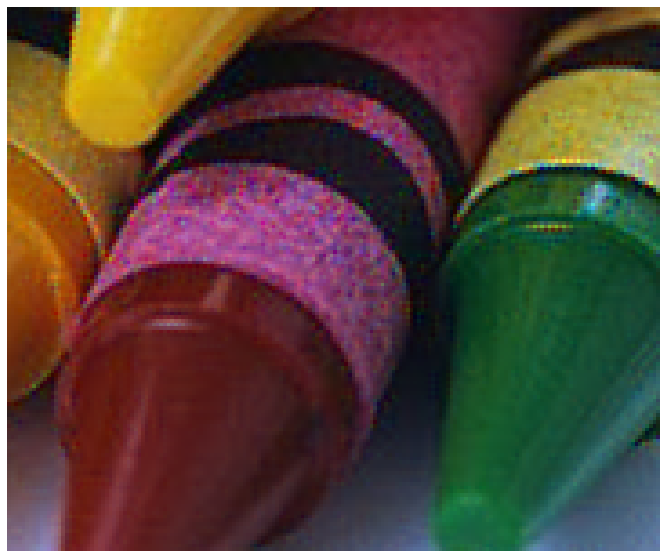

In [264]:
# focus on a small area
plot_image(rgb[300:450, 380:560, :], (20,10))

### Problem 6: Freeman's Method

In [265]:
from scipy.signal import medfilt2d

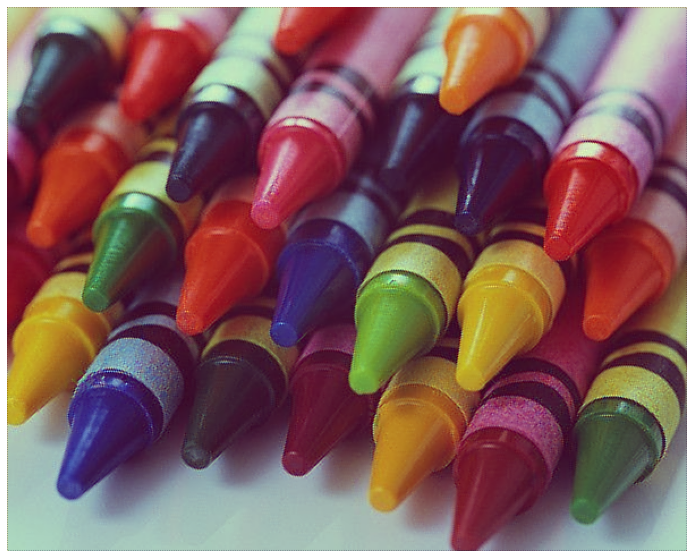

In [266]:
R, G, B = rgb[...,0], rgb[...,1], rgb[...,2]
Rscale = R.mean()
Gscale = G.mean()
Bscale = B.mean()

# your code here
# standardize the channels
R_scaled = R - Rscale
G_scaled = G - Gscale
B_scaled = B - Bscale


R2 = medfilt2d(R_scaled - G_scaled, kernel_size=3) + G_scaled
B2 = medfilt2d(B_scaled - G_scaled, kernel_size=3) + G_scaled


# normalize the output
R2 = 255 * (R2 - R2.min()) / (R2.max() - R2.min())
B2 = 255 * (B2 - B2.min()) / (B2.max() - B2.min())

cleaned_rgb = np.dstack((R2, G, B2))
plot_image(cleaned_rgb.astype(np.uint8), (20, 10))

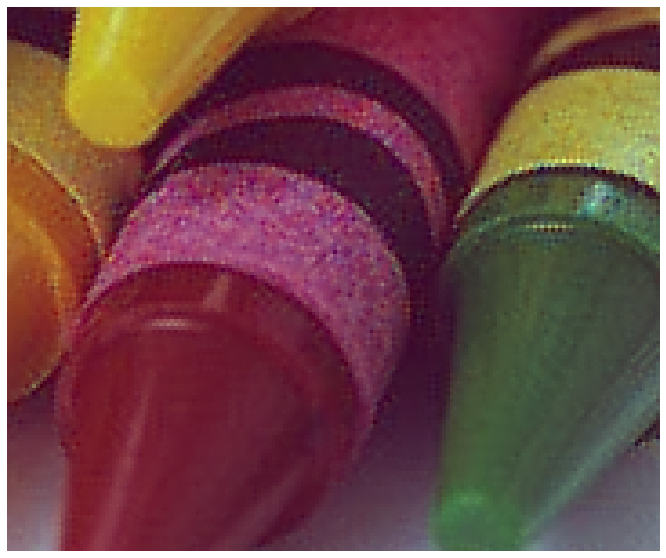

In [267]:
# focus on the same small area
plot_image(cleaned_rgb[300:450, 380:560, :].astype(np.uint8), (20,10))

### Choosing Kernel Size


Using kernel sizes [3, 5, 7, 11, 13, 15, 17, 21, 23, 25, 27, 31]


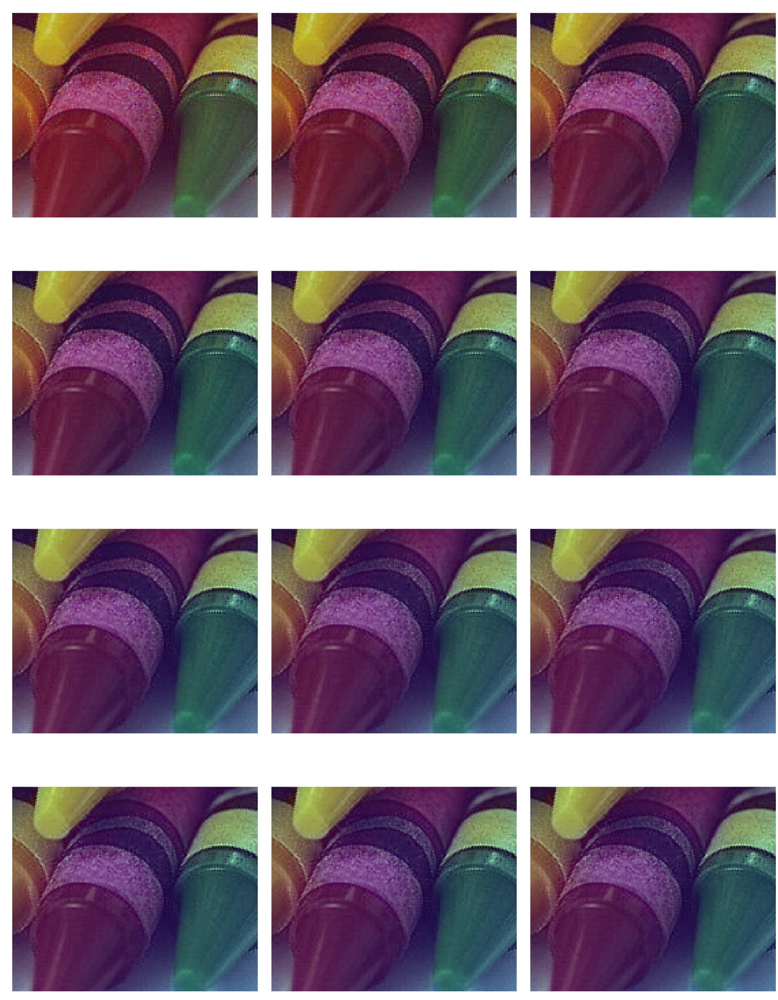

In [268]:
def freeman_method(rgb_image, kernel_size=3):
    """
    This function implements the freeman method for demosaicing.
    The function takes a linearly interpolated demosaiced image and applies the medfilt2d method.
    The function returns the demosaiced image.
    """
    
    rgb = rgb_image

    R, G, B = rgb[...,0], rgb[...,1], rgb[...,2]
    Rscale = R.mean()
    Gscale = G.mean()
    Bscale = B.mean()

    # your code here
    # standardize the channels
    R_scaled = R - Rscale
    G_scaled = G - Gscale
    B_scaled = B - Bscale


    R2 = medfilt2d(R_scaled - G_scaled, kernel_size=kernel_size) + G_scaled
    B2 = medfilt2d(B_scaled - G_scaled, kernel_size=kernel_size) + G_scaled


    # normalize the output
    R2 = 255 * (R2 - R2.min()) / (R2.max() - R2.min())
    B2 = 255 * (B2 - B2.min()) / (B2.max() - B2.min())

    return np.dstack((R2, G, B2))

# set number of kernels to experiment with
num_kernels = 12

# figure config
plot_cols = 3
plot_rows = np.ceil(num_kernels / plot_cols).astype(int)
fig, axs = plt.subplots(plot_rows, plot_cols, figsize=(30, 40))


# make list of kernel sizes (must be odd numbers)
kernel_sizes = [int(i+1) if i%2 == 0 else int(i) for i in np.linspace(3, 30, num_kernels) // 1]
print(f'Using kernel sizes {kernel_sizes}')
i, j = 0, 0

# run freeman method for each kernel size, plot results
for kernel in kernel_sizes:
    demosaiced_img = freeman_method(rgb, kernel)
    axs[i, j].imshow(demosaiced_img.astype(np.uint8)[300:450, 380:560, :], cmap='gray')
    axs[i, j].set_title('Kernel size: {}'.format(kernel), fontsize = 28, fontweight='bold')
    j += 1
    if j == plot_cols:
        i += 1
        j = 0
fig.tight_layout()
plt.show()

## Discussion
Add below your answers to qualitative questions about demosaicing artifacts

The Freeman method in this case works as intended, though it appears that the colors in the image are not as vibrant as in the linear interpolation original method. 

It may be the case that the Freeman method is combining the colors of the image in a way that is not ideal.

By applying the median of the kernel, colors are more evenly distributed, but this means that as the kernel size gets larger, the dominant colors of the image will tend to dominate over the other colors, given the viewer a sense that saturation has decreased.

If we look at the bigger kernel sizes in the plots above, we can see that as the kernel size increase, blue tones become more prevalent.

In this sense, artifacts with this method look better than on the original image, because artifacts are not as color-intense given the median filter applied, although the artifacts are still there, but they appear as brightness changes, rather than color changes. 